# Foundational Data: Boundaries and Population

Shapefiles are obtained from geoBoundaries and population files are from WorldPop.

In [7]:
# Auto-reload modules before executing code
%load_ext autoreload
%autoreload 2

import glob
import geopandas as gpd
import pandas as pd
from population import *
from get_raster import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
import os, pathlib
os.environ["MENA_FCV_LOCAL_DATA_DIR"] = str(pathlib.Path.home() / "MENA_FCV_data")

In [9]:
countries_with_conflict = pd.read_csv('../../data/conflict/acled_countries_with_conflict_one_fatality_no_peaceful_protests_2019_2024.csv')
countries_with_conflict = list(countries_with_conflict['country_code'].unique())

wb_regions_exclude = pd.read_csv('../../data/worldbank_regions_iso3_exclusions.csv')
wb_regions_exclude.drop(columns=['Unnamed: 0.1', 'Unnamed: 0'], inplace=True)
wb_regions_exclude = wb_regions_exclude[wb_regions_exclude['exclude']==1]['country_code'].unique().tolist()

countries_to_include = list(set(countries_with_conflict) - set(wb_regions_exclude))

In [10]:
wb_regions = pd.read_csv('../../data/boundaries/worldbank_regions_iso3.csv')
wb_regions = wb_regions[wb_regions['exclude']!=1.0]
wb_regions.drop(columns=['Unnamed: 0', 'Unnamed: 0.1'], inplace=True)

In [11]:
mena_countries = wb_regions[wb_regions['region_code']=='MEA']['country_code'].unique().tolist()

In [38]:
df_2000 = download_unadj_2020_ppp_constrained(
    ['AFG'], 
    year=2000,
    constrained=False,
    
    try_unconstrained_fallback=True,
    output_dir='${MENA_FCV_LOCAL_DATA_DIR}/population/2000'
)

AFG unconstrained (1km) 2000: 100%|██████████| 357M/357M [03:41<00:00, 1.61MB/s] 


In [15]:
# Population aggregation: parallel zonal sum of WorldPop 2020 UN-adj constrained raster over quadkey geometries.
# Steps:
# 1. Load per-country quadkey GeoPackage (here: a pre-built ECS region file as placeholder) – adapt gdf_path per ISO if needed.
# 2. Build input tuples (iso, row_id, geometry_geojson, raster_path).
# 3. Run process pool via op.run_quad_pool (chunksize tuned for throughput vs. memory).
# 4. Reconstruct GeoDataFrame and persist population sums (missing -> 0.0).
# Notes:
# - Adjust `workers` to match CPU cores; avoid oversubscription on I/O-bound network file systems.
# - Ensure raster filenames follow pattern {iso}_ppp_2020_UNadj_constrained.tif.
# - gdf_path currently hard-coded; for multi-country run, loop ISO and build path per ISO.
import os, sys
from pathlib import Path
import geopandas as gpd
import pandas as pd
import numpy as np
import pathlib

workers = 6
iso_codes = mena_countries  # target countries for population overlay

zoom = 12

# Ensure repository root is importable for src.ookla_processing
repo_root = os.path.abspath(os.path.join(os.getcwd(), '..', '..'))
if repo_root not in sys.path:
    sys.path.insert(0, repo_root)

# Optional GDAL tuning (safe defaults); can further tune GDAL_CACHEMAX per memory budget.
os.environ.setdefault('GDAL_CACHEMAX', '512')
os.environ.setdefault('GDAL_NUM_THREADS', str(min(8, (os.cpu_count() or 2))))

from src import ookla_processing as op

results_dir = f'../../data/population/2000/polygons/zoom{zoom}' 
Path(results_dir).mkdir(parents=True, exist_ok=True)

# Build quad-level inputs across selected countries
inputs = []
gdf_map = {}  # iso -> (GeoDataFrame, raster_path)
for iso in iso_codes:
    iso_upper = str(iso).upper()
    iso_lower = iso_upper.lower()
    gdf_path = f'../../data/boundaries/mea_highfat_ucdp_acled_2000.gpkg'  # TODO: replace with per-ISO grid if available
    raster_path = str(pathlib.Path.home() / "MENA_FCV_data") + f'/population/2000/{iso_lower}_ppp_2000_1km_UNadj.tif'
    if not os.path.exists(gdf_path):
        print('  missing gdf:', gdf_path)
        continue
    if not os.path.exists(raster_path):
        print('  missing raster:', raster_path)
        continue
    gdf = gpd.read_file(gdf_path)
    if 'index' not in gdf.columns:
        gdf = gdf.reset_index().rename(columns={'index':'index'})
    gdf_map[iso_upper] = (gdf, raster_path)
    for row_id, geom in enumerate(gdf.geometry):
        inputs.append((iso_upper, row_id, geom.__geo_interface__, raster_path))

if not inputs:
    raise RuntimeError('No valid inputs found. Check iso_codes and that GPKG/raster files exist.')

# Parallel by quadkey using your workers value; adjust chunksize upward (e.g., 512/1024) for very large task sets.
print(f"Running quad pool with workers={workers}, tasks={len(inputs)}")
results = op.run_quad_pool(inputs, max_workers=workers, chunksize=256)

# Reconstruct per-country GeoDataFrames and write outputs
by_iso = {}
for iso_out, row_id, pop_sum in results:
    by_iso.setdefault(iso_out, {})[row_id] = np.nan if pop_sum is None else float(pop_sum)

for iso_out, row_map in by_iso.items():
    gdf, _raster = gdf_map[iso_out]
    pop_sums = [row_map.get(i, np.nan) for i in range(len(gdf))]
    gdf = gdf.copy()
    gdf['population'] = np.nan_to_num(pop_sums, nan=0.0)
    out_path = os.path.join(results_dir, f'gdf_{iso_out}.gpkg')
    gdf.to_file(out_path)
    print('  saved ->', out_path)

print('Done.')

Running quad pool with workers=6, tasks=3549
  saved -> ../../data/population/2000/polygons/zoom12/gdf_AFG.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_ARE.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_BHR.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_DJI.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_DZA.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_EGY.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_IRN.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_IRQ.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_JOR.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_KWT.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_LBN.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_LBY.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_MAR.gpkg
  saved -> ../../data/population/2000/polygons/zoom12/gdf_OMN.gpkg
  saved -> ../../

In [26]:
pop_highfat = pd.DataFrame()

for file in glob.glob('../../data/population/2000/polygons/zoom12/gdf_*.gpkg'):
    iso = os.path.basename(file).split('_')[1].split('.')[0]
    gdf = gpd.read_file(file)
    gdf['country_code'] = iso
    gdf = gdf[gdf['population']>0]
    pop_highfat = pd.concat([pop_highfat, gdf[['index', 'population', 'country_code']]], ignore_index=True)

In [24]:
iso = gpd.read_file('../../data/population/2000/polygons/zoom12/gdf_DZA.gpkg')
iso = iso[iso['population']>0]

In [30]:
pop_highfat.groupby('country_code')['population'].sum()

country_code
AFG    2.835790e+05
DZA    5.334236e+06
EGY    4.130641e+06
IRN    4.706774e+05
IRQ    4.060537e+05
LBN    1.100517e+05
LBY    5.743980e+04
PAK    7.825366e+03
PSE    1.416476e+06
YEM    1.207514e+05
Name: population, dtype: float64

In [31]:
pop_highfat.to_csv('../../data/ucdp/pop_highfat_ucdp_acled_2000.csv')

In [ ]:
population_quadkeys['region_code'] = population_quadkeys['country_code'].map(country_to_region)

In [32]:
# --- Total population per country from WorldPop .tif files ---
import os
import re
import numpy as np
import pandas as pd
import rasterio


def _sum_raster_cells(src_path: str, band: int = 1, treat_negative_as_nodata: bool = True) -> float:
    """Return the sum of all valid cells in a raster band, streaming over blocks.

    - Respects dataset nodata; also drops negatives by default (common in some population rasters).
    - Uses block_windows to avoid loading the full raster into memory.
    """
    total = 0.0
    with rasterio.open(src_path) as ds:
        nodata = ds.nodata
        for _, window in ds.block_windows(band):
            arr = ds.read(band, window=window, masked=False).astype("float64")
            if nodata is not None:
                arr[arr == nodata] = np.nan
            if treat_negative_as_nodata:
                arr[arr < 0] = np.nan
            total += np.nansum(arr)
    return float(total)


def summarize_population_from_tifs(tif_inputs):
    """
    Summarize total population per country by summing all cells in each country's .tif.

    Parameters
    - tif_inputs: either
        * dict {iso3_code (str) -> tif_path (str)}
        * list/iterable of tif_path (str); in this case, the iso3_code is inferred from filename
          using pattern `([a-z]{3})_ppp_` (case-insensitive).

    Returns
    - DataFrame with columns: ['iso3', 'totalPopulation']
    """
    rows = []

    def infer_iso_from_path(path: str) -> str:
        fname = os.path.basename(path)
        m = re.search(r"([a-z]{3})_ppp_", fname, flags=re.IGNORECASE)
        if m:
            return m.group(1).upper()
        # fallback: take leading 3 letters
        return fname[:3].upper()

    # Normalize inputs to (iso, path) pairs
    if isinstance(tif_inputs, dict):
        items = [(iso.upper(), path) for iso, path in tif_inputs.items()]
    else:
        items = []
        for path in tif_inputs:
            iso = infer_iso_from_path(path)
            items.append((iso, path))

    for iso, path in items:
        if not os.path.exists(path):
            rows.append({"iso3": iso, "totalPopulation": np.nan})
            continue
        total = _sum_raster_cells(path)
        rows.append({"iso3": iso, "totalPopulation": total})

    return pd.DataFrame(rows).sort_values("iso3").reset_index(drop=True)

In [33]:
iso_codes = wb_regions[wb_regions['region_code']=='MEA']['country_code'].unique().tolist()

In [39]:
# Build paths dict from standard naming pattern for each ISO
paths = {iso: str(pathlib.Path.home() / "MENA_FCV_data") + f'/population/2000/{iso.lower()}_ppp_2000_1km_UNadj.tif' for iso in iso_codes}
df_totals = summarize_population_from_tifs(paths)


In [40]:
df_totals

,iso3,totalPopulation
0,AFG,2.077996e+07
1,ARE,3.134067e+06
2,BHR,6.646100e+05
3,DJI,7.175770e+05
4,DZA,3.104224e+07
5,EGY,6.883156e+07
6,IRN,6.562340e+07
7,IRQ,2.349759e+07
8,JOR,5.122495e+06
9,KWT,2.045123e+06


In [452]:
paths ={iso: str(pathlib.Path.home() / "MENA_FCV_data") + f'/{iso.lower()}_ppp_2020_UNadj_constrained.tif' for iso in remaining2}
df_remaining2 = summarize_population_from_tifs(paths)

In [497]:
country_to_region = wb_regions[['country_code', 'region_code']].set_index('country_code').to_dict()['region_code']

In [498]:
total_pop = pd.concat([df_totals.dropna(subset=['totalPopulation']), df_remaining.dropna(subset=['totalPopulation']), df_remaining2.dropna(subset=['totalPopulation'])]).reset_index(drop=True)
total_pop.rename(columns={'iso3':'country_code'}, inplace=True)
total_pop['region_code'] = total_pop['country_code'].map(country_to_region)

In [ ]:
total_pop[total_pop['country_code']=='PNG']['totalPopulation'].sum()

np.float64(8752518.019536972)

In [598]:
total_pop.to_csv('../../data/population/global_total_population_worldpop2020.csv')

In [595]:
total_pop = pd.read_csv('../../data/population/global_total_population_worldpop2020.csv')

In [596]:
df_totals.rename(columns={'iso3':'country_code'}, inplace=True)
df_totals['region_code'] = df_totals['country_code'].map(country_to_region)
df_totals

,country_code,totalPopulation,region_code
0,IND,1.380004e+09,SAS


In [597]:
total_pop = pd.concat([df_totals, total_pop])

In [446]:
remaining2 = (df_remaining[df_remaining['totalPopulation'].isna()]['iso3'].unique())

In [431]:
remaining = df_totals[df_totals['totalPopulation'].isna()]['iso3'].unique()

In [456]:
set(wb_regions[wb_regions['region_code']=='ECS']['country_code'].unique()) - set(total_pop['iso3'].unique())

{'XKX'}

In [411]:
wb_regions.groupby('region_code')['country_code'].nunique()

region_code
EAS    22
ECS    29
LCN    35
MEA    21
SAS     6
SSF    47
Name: country_code, dtype: int64

In [489]:
global_pop_total.groupby('region_code')['population'].sum()

region_code
EAS    9.146174e+08
ECS    3.218386e+08
LCN    6.338619e+08
MEA    7.144130e+08
SAS    2.081971e+08
SSF    1.135187e+09
Name: population, dtype: float64

In [487]:
global_pop.to_csv('../../data/population/polygons/global_pop_quad12.csv')

In [343]:
len(countries_to_include)

138

In [ ]:
len(mea['country_code'].unique()) + len(sas['country_code'].unique()) + len(lcn['country_code'].unique()) + len(ssf['country_code'].unique()) + len(ecs['country_code'].unique())

120

In [346]:
countries_pop = (list(mea['country_code'].unique()) + list(sas['country_code'].unique()) + list(lcn['country_code'].unique()) + list(ssf['country_code'].unique()) + list(ecs['country_code'].unique()))

In [351]:
(set(countries_to_include) - set(countries_pop)) - set(['CHN', 'IDN', 'KHM', 'LAO', 'MMR', 'MYS', 'PHL', 'PNG', 'PRK', 'SLB', 'THA', 'TLS', 'VNM', 'VUT'])

{'IND', 'RUS', 'XKX', nan}

In [33]:
population.to_file('../../data/population/polygons/MENAAP_pop_quad13.gpkg', driver='GPKG')

In [25]:
population_menaap.to_file('../../data/population/polygons/MENAAP_pop_quad12.gpkg', driver='GPKG')

In [8]:
wb_regions = pd.read_csv('../../data/boundaries/worldbank_regions_iso3.csv')

In [ ]:
for region_code in wb_regions['region_code'].unique().tolist():
    gdf = gpd.read_file(f'../../data/boundaries/{region_code}_regional_quadkey13.gpkg')
    gdf.plot(column='region_code', legend=True, figsize=(10,10)

In [5]:
# import geopandas as gpd
# import glob
# import pandas as pd
# boundaries_adm0 = gpd.GeoDataFrame()

# for file in glob.glob('../../data/boundaries/*_ADM0_*.geojson'):
#     gdf = gpd.read_file(file)
#     boundaries_adm0 = pd.concat([boundaries_adm0, gdf], ignore_index=True)

# boundaries_adm1 = gpd.GeoDataFrame()

# # for file in glob.glob('../../data/boundaries/*_ADM1_*.geojson'):
# #     gdf = gpd.read_file(file)
# #     boundaries_adm1 = pd.concat([boundaries_adm1, gdf], ignore_index=True)

# # boundaries_adm2 = gpd.GeoDataFrame()

# # for file in glob.glob('../../data/boundaries/*_ADM2_*.geojson'):
# #     gdf = gpd.read_file(file)
# #     boundaries_adm2 = pd.concat([boundaries_adm2, gdf], ignore_index=True)

## Boundaries for Region of Interest

<Axes: >

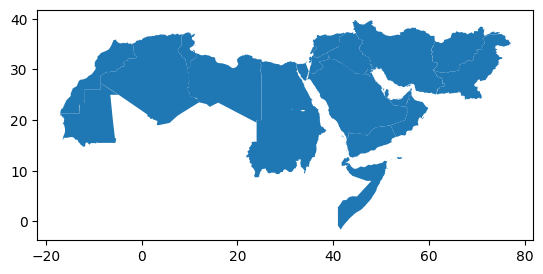

In [14]:
boundaries_adm0.plot()

In [15]:
boundaries_adm1.explore()

In [39]:
population['population'] = population['population'].astype('float64')

In [40]:
population = population[population['population']>0]

In [41]:
population.to_file('../../data/population/polygons/regional_population.gpkg')